# Project Overview 
## <b>Background & Context</b>

The Thera bank recently saw a steep decline in the number of users of their credit card, credit cards are a good source of income for banks because of different kinds of fees charged by the banks like annual fees, balance transfer fees, and cash advance fees, late payment fees, foreign transaction fees, and others. Some fees are charged to every user irrespective of usage, while others are charged under specified circumstances.

Customers’ leaving credit cards services would lead bank to loss, so the bank wants to analyze the data of customers and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas

You as a Data scientist at Thera bank need to come up with a classification model that will help the bank improve their services so that customers do not renounce their credit cards

## <b> Objective</b>


<li>Explore and visualize the dataset.</li>
<li>Build a classification model to predict if the customer is going to churn or not</li>
<li>Optimize the model using appropriate techniques</li>
<li>Generate a set of insights and recommendations that will help the bank</li>

## Data Dictionary

<ul>
<li>CLIENTNUM: Client number. Unique identifier for the customer holding the account</li>
<li>Attrition_Flag: Internal event (customer activity) variable - if the account is closed then&nbsp;"Attrited Customer" else "Existing Customer"</li>
<li>Customer_Age: Age in Years</li>
<li>Gender: Gender of the account holder</li>
<li>Dependent_count: Number of dependents</li>
<li>Education_Level:&nbsp;&nbsp;Educational Qualification of the account holder - Graduate, High School, Unknown, Uneducated, College(refers to a college student), Post-Graduate, Doctorate.</li>
<li>Marital_Status: Marital Status of the account holder</li>
<li>Income_Category: Annual Income Category of the account holder</li>
<li>Card_Category: Type of Card</li>
<li>Months_on_book: Period of relationship with the bank</li>
<li>Total_Relationship_Count: Total no. of products held by the customer</li>
<li>Months_Inactive_12_mon: No. of months inactive in the last 12 months</li>
<li>Contacts_Count_12_mon: No. of Contacts between the customer and bank in the last 12 months</li>
<li>Credit_Limit: Credit Limit on the Credit Card</li>
<li>Total_Revolving_Bal:&nbsp;The balance that carries over from one month to the next is the revolving balance</li>
<li>Avg_Open_To_Buy:&nbsp;Open to Buy refers to the amount left on the credit card to use&nbsp;(Average of last 12 months)</li>
<li>Total_Trans_Amt: Total Transaction Amount (Last 12 months)</li>
<li>Total_Trans_Ct: Total Transaction Count (Last 12 months)</li>
<li>Total_Ct_Chng_Q4_Q1: Ratio of the total transaction count in 4th quarter and&nbsp;the total transaction count in&nbsp;1st quarter</li>
<li>Total_Amt_Chng_Q4_Q1:&nbsp;Ratio of the total transaction amount in 4th quarter and the&nbsp;total transaction amount in&nbsp;1st quarter</li>
<li>Avg_Utilization_Ratio:&nbsp;Represents how much of the available credit the customer spent</li>
</ul>


# Data Load and Read them 

## Import necessary Library

In [1]:
# Library to suppress warnings or deprecation notes 
import warnings
warnings.filterwarnings('ignore')

# Libraries to help with reading and manipulating data
import numpy as np
import pandas as pd

#from pandas setting the output to 3 float decimal point
pd.set_option('display.float_format', lambda x: '%.f' % x)
pd.set_option('max_columns',None)

# Libraries to help with data visualization
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

# Library to split data and preprocessing
from sklearn.model_selection import train_test_split,StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler,LabelEncoder

# Libraries to import decision tree classifier and different ensemble classifiers
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier

from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn import tree

# Libtune to tune model, get different metric scores
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, precision_score, recall_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.linear_model import LogisticRegression

## Read the Data

In [151]:
data=pd.read_csv("BankChurners.csv")
data1=data.copy()

## First and Last few rows

In [3]:
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691,777,11914,1,1144,42,2,0
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256,864,7392,2,1291,33,4,0
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418,0,3418,3,1887,20,2,0
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313,2517,796,1,1171,20,2,1
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716,0,4716,2,816,28,2,0


In [4]:
data.tail()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003,1851,2152,1,15476,117,1,0
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277,2186,2091,1,8764,69,1,1
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409,0,5409,1,10291,60,1,0
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281,0,5281,1,8395,62,1,0
10126,714337233,Attrited Customer,43,F,2,Graduate,Married,Less than $40K,Silver,25,6,2,4,10388,1961,8427,1,10294,61,1,0


<p><b>Observation:</b> 
  <p>we have few data types as object which can be converted to categorical variable </p>
  <p>we do not see any data that is missing all of them has the same rows as 10127</p>


## Summary of test data

In [5]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127,739177606,36903783,708082083,713036770,717926358,773143533,828343083
Customer_Age,10127,46,8,26,41,46,52,73
Dependent_count,10127,2,1,0,1,2,3,5
Months_on_book,10127,36,8,13,31,36,40,56
Total_Relationship_Count,10127,4,2,1,3,4,5,6
Months_Inactive_12_mon,10127,2,1,0,2,2,3,6
Contacts_Count_12_mon,10127,2,1,0,2,2,3,6
Credit_Limit,10127,8632,9089,1438,2555,4549,11068,34516
Total_Revolving_Bal,10127,1163,815,0,359,1276,1784,2517
Avg_Open_To_Buy,10127,7469,9091,3,1324,3474,9859,34516


In [175]:
data1.shape

(10127, 21)

<p>Observation:<br />Average age group is 46 <br />On an average there seems to be 2 dependants<br />average months inactive is also 2<br />The mean credit limit and 50% value seems to vary a lot <br />Total revolving balance seems to be close to 1162.814<br />Average transaction count on an average seems to be 64<br />There seems to be atleast 2 contacts in 1 months<br /> Average utilisation ratio seems to vary from min 0 to max 1</p>
<p>We have 21 columns ans 10127 rows</p>


## Finding Unique Values

In [6]:
data.nunique()

CLIENTNUM                   10127
Attrition_Flag                  2
Customer_Age                   45
Gender                          2
Dependent_count                 6
Education_Level                 7
Marital_Status                  4
Income_Category                 6
Card_Category                   4
Months_on_book                 44
Total_Relationship_Count        6
Months_Inactive_12_mon          7
Contacts_Count_12_mon           7
Credit_Limit                 6205
Total_Revolving_Bal          1974
Avg_Open_To_Buy              6813
Total_Amt_Chng_Q4_Q1         1158
Total_Trans_Amt              5033
Total_Trans_Ct                126
Total_Ct_Chng_Q4_Q1           830
Avg_Utilization_Ratio         964
dtype: int64

## checking for null values in the data set

In [7]:
data.isna().sum()

CLIENTNUM                   0
Attrition_Flag              0
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64

Observation: There is no Null values

## Checking value counts for categorical variable

In [8]:
# Making a list of all catrgorical variables
cat_col = [
    "Attrition_Flag",
    "Gender",
    "Education_Level",
    "Marital_Status",            
    "Income_Category",
    "Card_Category"
]

# Printing number of count of each unique value in each column
for column in cat_col:
    print(data[column].value_counts())

    print("-" * 40)
    


Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64
----------------------------------------
F    5358
M    4769
Name: Gender, dtype: int64
----------------------------------------
Graduate         3128
High School      2013
Unknown          1519
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64
----------------------------------------
Married     4687
Single      3943
Unknown      749
Divorced     748
Name: Marital_Status, dtype: int64
----------------------------------------
Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
Unknown           1112
$120K +            727
Name: Income_Category, dtype: int64
----------------------------------------
Blue        9436
Silver       555
Gold         116
Platinum      20
Name: Card_Category, dtype: int64
----------------------------------------


## Checking the Percentage of each category 

In [9]:
# Printing number of count of each unique value in each column
for column in cat_col:    
    print(data[column].value_counts(normalize=True)*100 )
    print("-" * 40)

Existing Customer   84
Attrited Customer   16
Name: Attrition_Flag, dtype: float64
----------------------------------------
F   53
M   47
Name: Gender, dtype: float64
----------------------------------------
Graduate        31
High School     20
Unknown         15
Uneducated      15
College         10
Post-Graduate    5
Doctorate        4
Name: Education_Level, dtype: float64
----------------------------------------
Married    46
Single     39
Unknown     7
Divorced    7
Name: Marital_Status, dtype: float64
----------------------------------------
Less than $40K   35
$40K - $60K      18
$80K - $120K     15
$60K - $80K      14
Unknown          11
$120K +           7
Name: Income_Category, dtype: float64
----------------------------------------
Blue       93
Silver      5
Gold        1
Platinum    0
Name: Card_Category, dtype: float64
----------------------------------------


<p><b>In Education Level&nbsp;</b></p>
<p><span style="white-space:pre;">&nbsp; &nbsp;&nbsp;</span>we have unknown category -14% that need to be fixed</p>
<p><b>In Marital status&nbsp;</b></p>
<p>We have Most of the customers as Married -46% of them and single as 39%&nbsp;</p>
<p><span style="white-space:pre;">&nbsp; &nbsp;&nbsp;</span>unknown as a category-0.07% which need to be fixed&nbsp;</p>
<p><b>In Income category&nbsp;</b></p>
<p>In Income category we have most customer less than 40k (35 %) and very few who earns more than 120K(0.07%) and&nbsp;</p>
<p><span style="white-space:pre;">&nbsp; &nbsp;&nbsp;</span>10% are unknown category which has to be fixed.</p>
<p><b>In Card Category&nbsp;</b></p>
<p>In Card Category we have blue 93% as topper and then silver-5%,gold-1%,Platinum-0% respectively</p>

<b>Decision Based on above observation</b>
<b>We can replace Nan for unknown to fill Nan with mode of the categorical values as Income category and Education Level</b>

## Finding mode of the categorical value to replace onto the unknown while preprocessing

In [10]:
data.select_dtypes('object').mode()

,Attrition_Flag,Gender,Education_Level,Marital_Status,Income_Category,Card_Category
0,Existing Customer,F,Graduate,Married,Less than $40K,Blue


## Visualize missing values

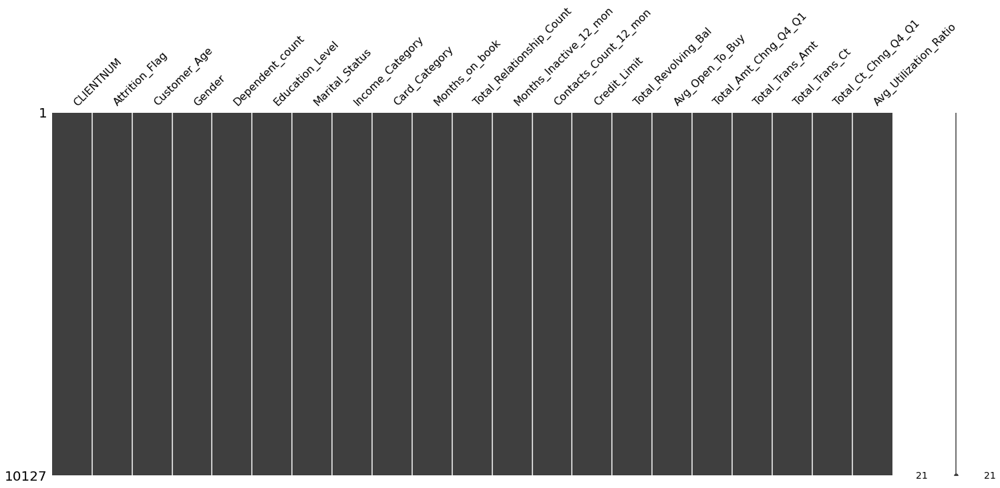

In [11]:
import missingno as msno
msno.matrix(data)


Observation:No missing Values at all .

# Exploratory Data Analysis

## Univariate analysis

###  Program for histogram and boxplot with shared x axis and creating a subplot and * value includes Mean

In [12]:
# While doing uni-variate analysis of numerical variables we want to study their central tendency
# and dispersion.
# Let us write a function that will help us create a boxplot and histogram for any input numerical
# variable.
# This function takes the numerical column as the input and returns the boxplots
# and histograms for the variable.
# Let us see if this helps us write faster and cleaner code.
def histogram_boxplot(feature, figsize=(15, 10), bins=None):
    """Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.distplot(
        feature, kde=F, ax=ax_hist2, bins=bins, color="orange"
    ) if bins else sns.distplot(
        feature, kde=False, ax=ax_hist2, color="tab:cyan"
    )  # For histogram
    ax_hist2.axvline(
        np.mean(feature), color="purple", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        np.median(feature), color="black", linestyle="-"
    )  # Add median to the histogram

In [13]:
data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

In [14]:
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

### Observation on Customer Age

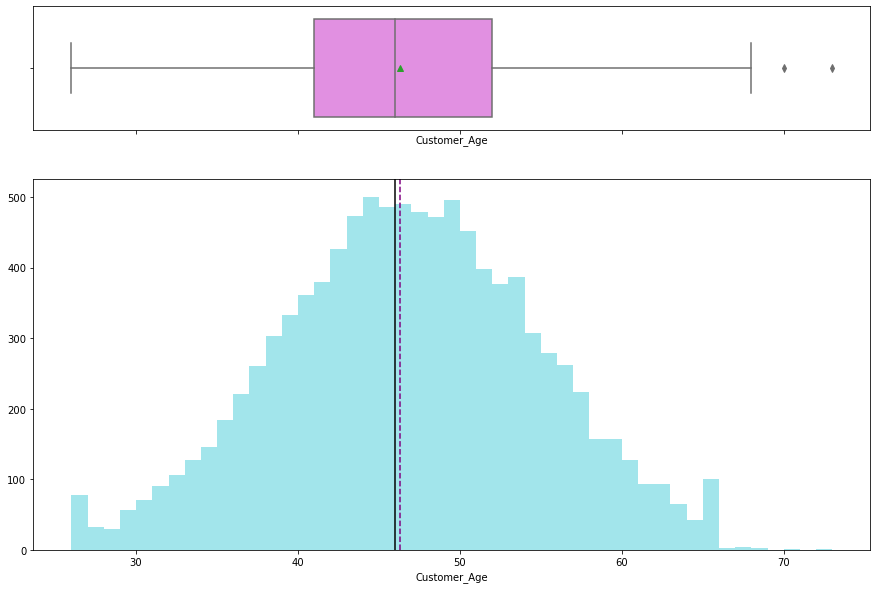

In [15]:
histogram_boxplot(data["Customer_Age"])

Observation Age Ranges from 26-73

### Observation on dependent count

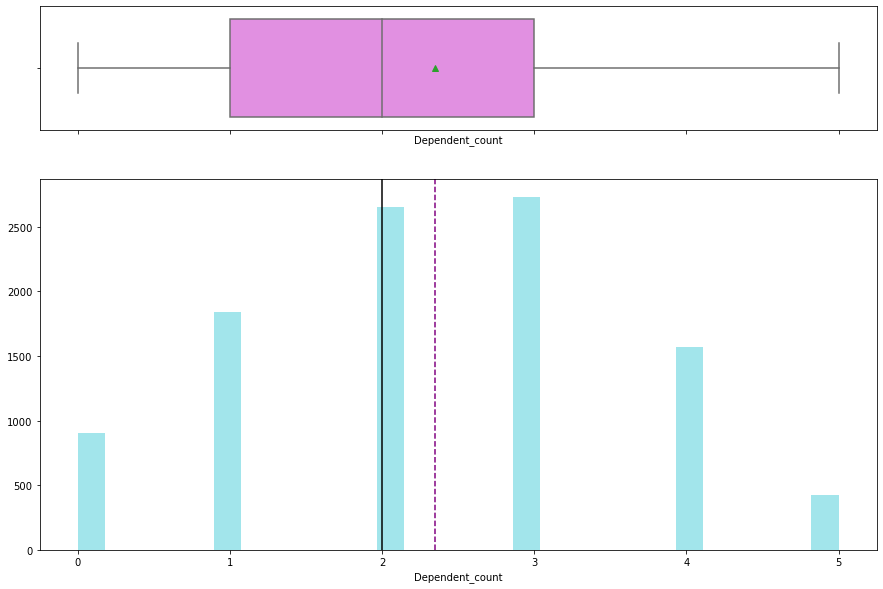

In [16]:
histogram_boxplot(data["Dependent_count"])

### Observation on months on book 

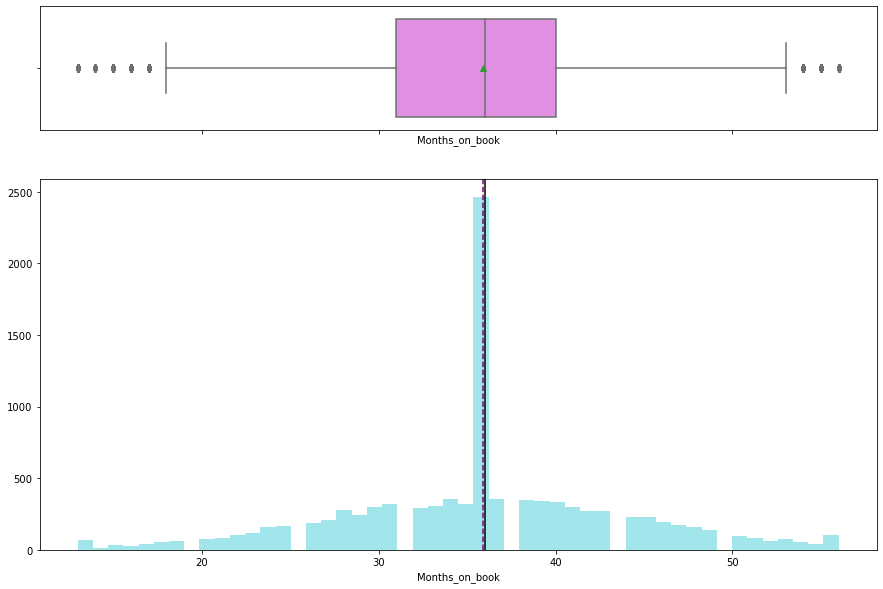

In [17]:
histogram_boxplot(data["Months_on_book"])

### Observation on Total relationship count

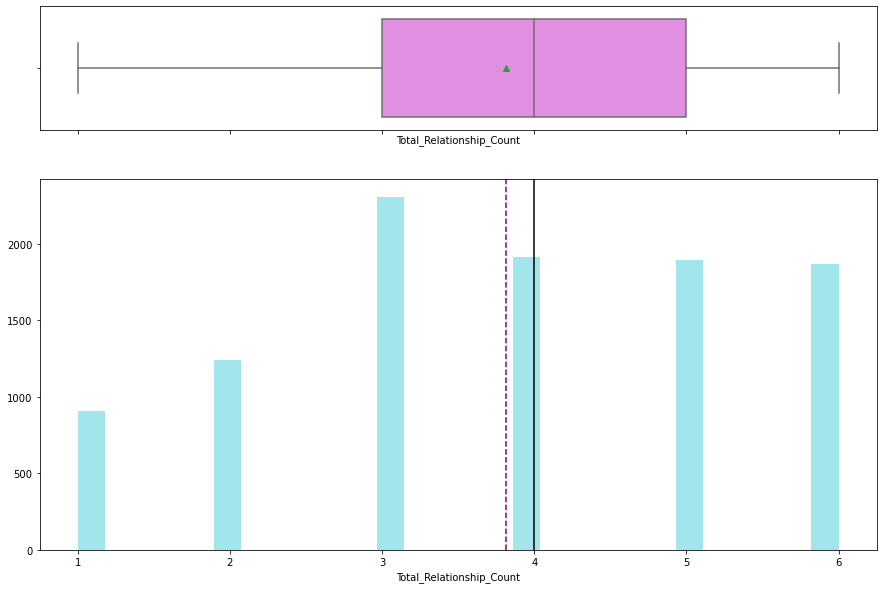

In [18]:
histogram_boxplot(data["Total_Relationship_Count"])

###  observation on Months inactive

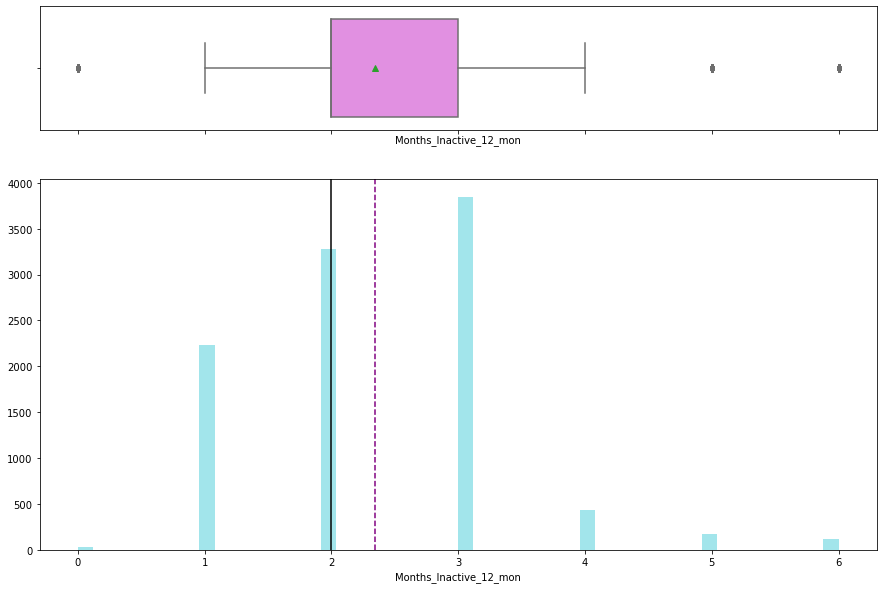

In [19]:
histogram_boxplot(data["Months_Inactive_12_mon"])

### Observation on credit limit

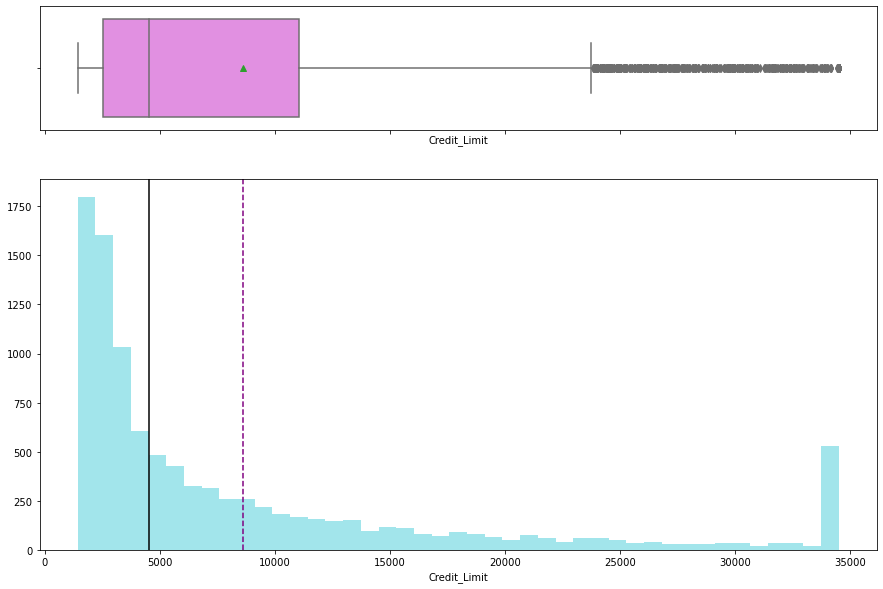

In [20]:
histogram_boxplot(data["Credit_Limit"])

 ### Observation on Total_Revolving_Bal

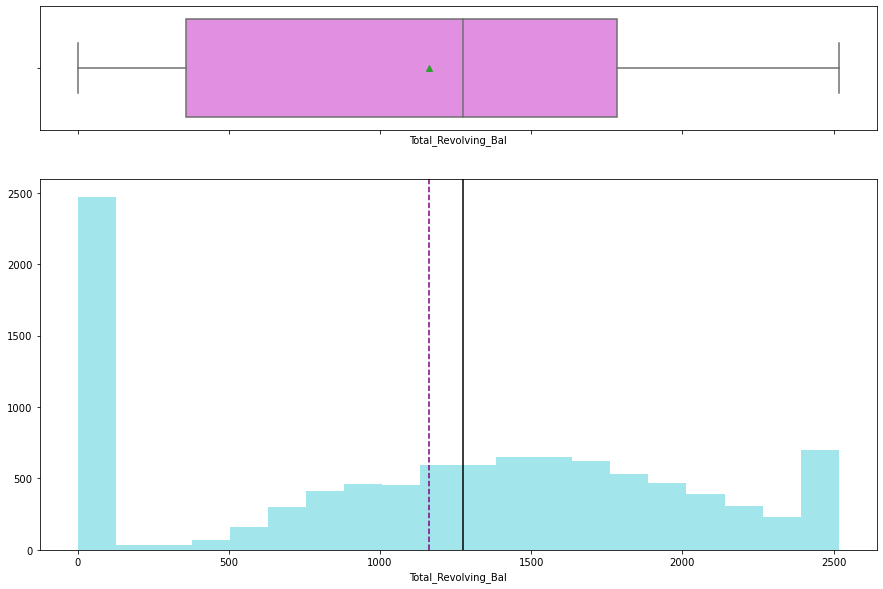

In [21]:
histogram_boxplot(data["Total_Revolving_Bal"])

### Observation on Avg_Open_To_Buy  

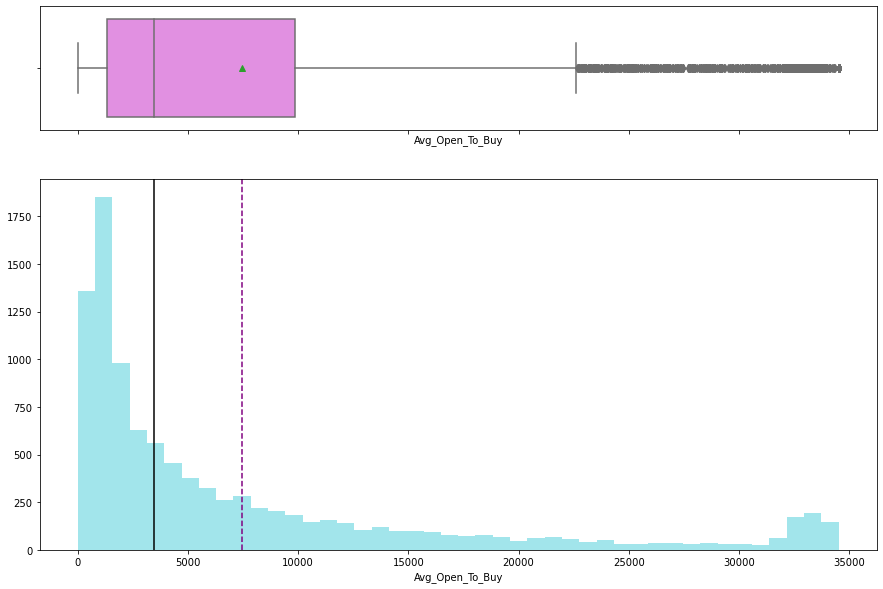

In [22]:
histogram_boxplot(data["Avg_Open_To_Buy"])

### Observation on Total_Amt_Chng_Q4_Q1

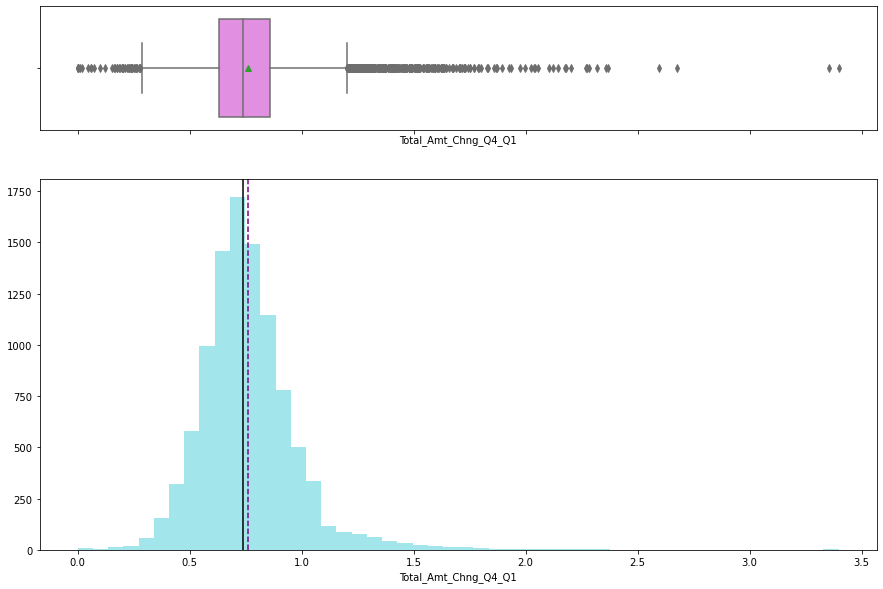

In [23]:
histogram_boxplot(data["Total_Amt_Chng_Q4_Q1"])

### Observation on Total_Trans_Amt

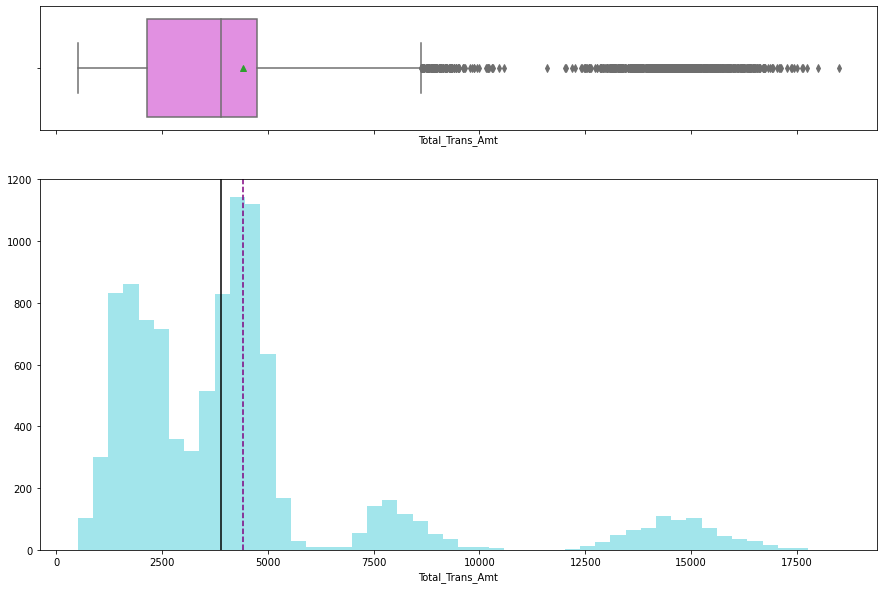

In [24]:
histogram_boxplot(data["Total_Trans_Amt"])

### Observation on Total_Trans_Ct

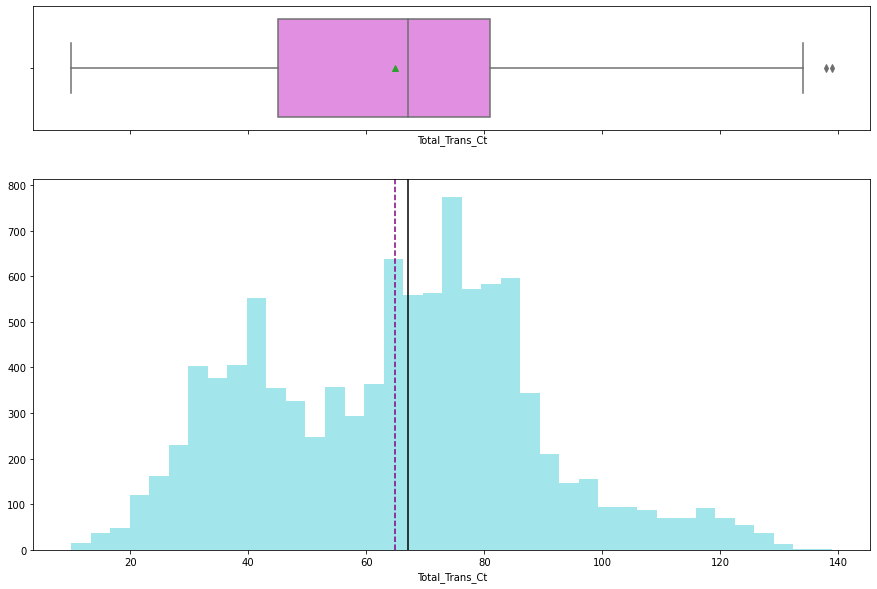

In [25]:
histogram_boxplot(data["Total_Trans_Ct"])

### Observation on Total_Ct_Chng_Q4_Q1

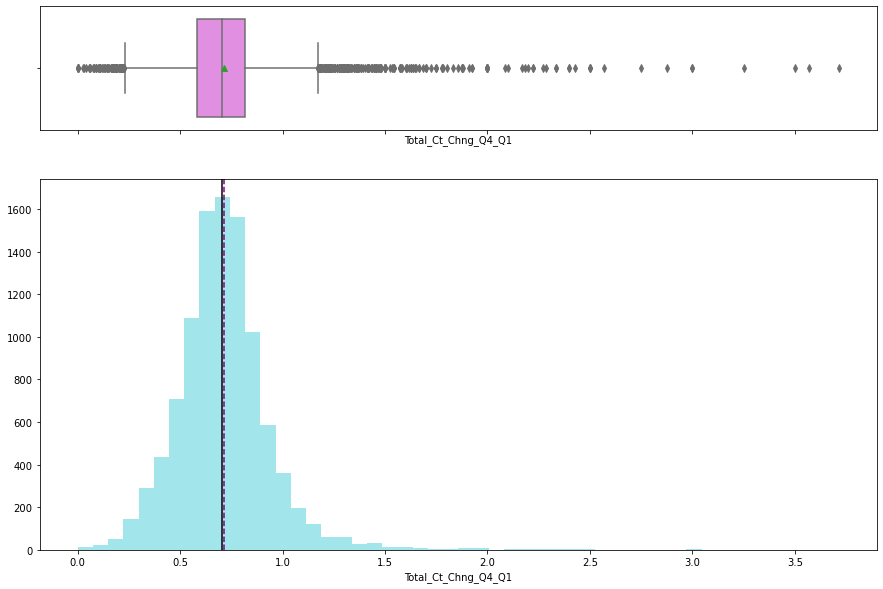

In [26]:
histogram_boxplot(data["Total_Ct_Chng_Q4_Q1"])

### Observation on Avg_Utilization_Ratio

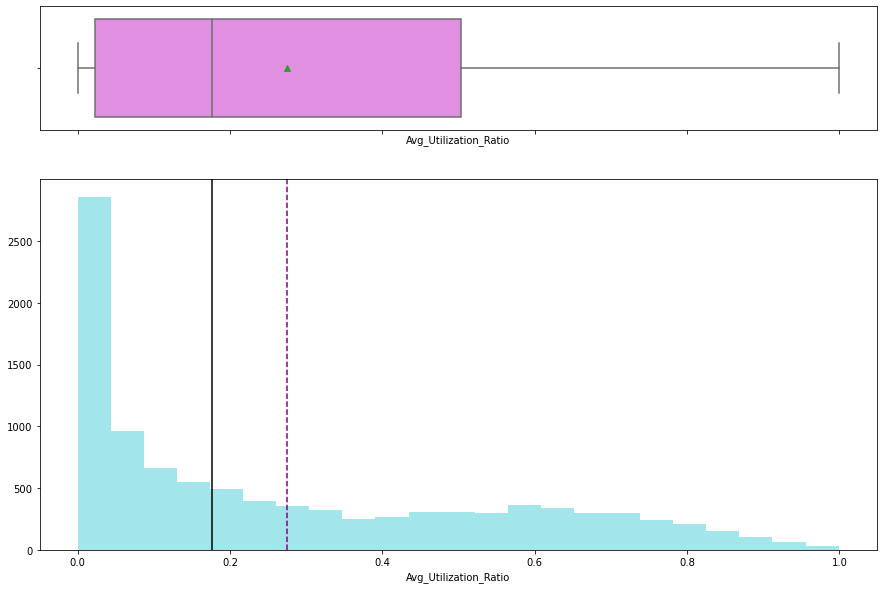

In [27]:
histogram_boxplot(data["Avg_Utilization_Ratio"])

## Panda Profiling

In [28]:
from pandas_profiling import ProfileReport

In [152]:
prof = ProfileReport(data1)
# to view report created by pandas profile
prof

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<p><b>Observation:</b></p>
<p>Atrrium Frequency &nbsp;&nbsp;</p>
<p>&nbsp; &nbsp; Existing 83.9%</p>
<p>&nbsp; &nbsp; Attrited 16.1%</p>
<p>As Attrited is just 16.1% and existing customer is 83.9% this data set is an imbalanced data set</p>
<p>Age value ranges from 26 to 73 and average range of 47 &nbsp;</p>
<p>Gender 52.9 % Female and 47.1% Male</p>
<p>Dependant count is mostly 3 with 27.0% and 2 in 26.2% 1 as 18.1% and 4 with 15.5% 0 in 8.9% and 5 is the lease as 4.2%</p>
<p>Education level Graduate 30.9% and High school 19.9% unknown value is 15% with will be replaced by mode value as Graduate &nbsp; in preprocessing and uneducated as 14.7%</p>
<p>Marital status married 46.3% and single as 38.9% and divorced as 7.4% we have a 7.4% of unknown data which will be taken &nbsp; &nbsp;care by one hot coding&nbsp;</p>
<p>Income Category less than $40k is 35.2% is the most &nbsp;and we have some unknown value close to 11% which can be filled with &nbsp; mode at the preprocessing</p>
<p>Card_Category Blue is the maximum 93.2% and &nbsp;no missing values</p>
<p>&nbsp;</p>
<p>&nbsp;</p>
 
 

## Bivariate analaysis

In [ ]:
Attrition_Flag

In [ ]:
sns.countplot(x='Age',data=data,hue='Attrition_Flag')

### Pairplot

In [30]:
sns.set(font_scale=1.75)

Wall time: 1min 2s


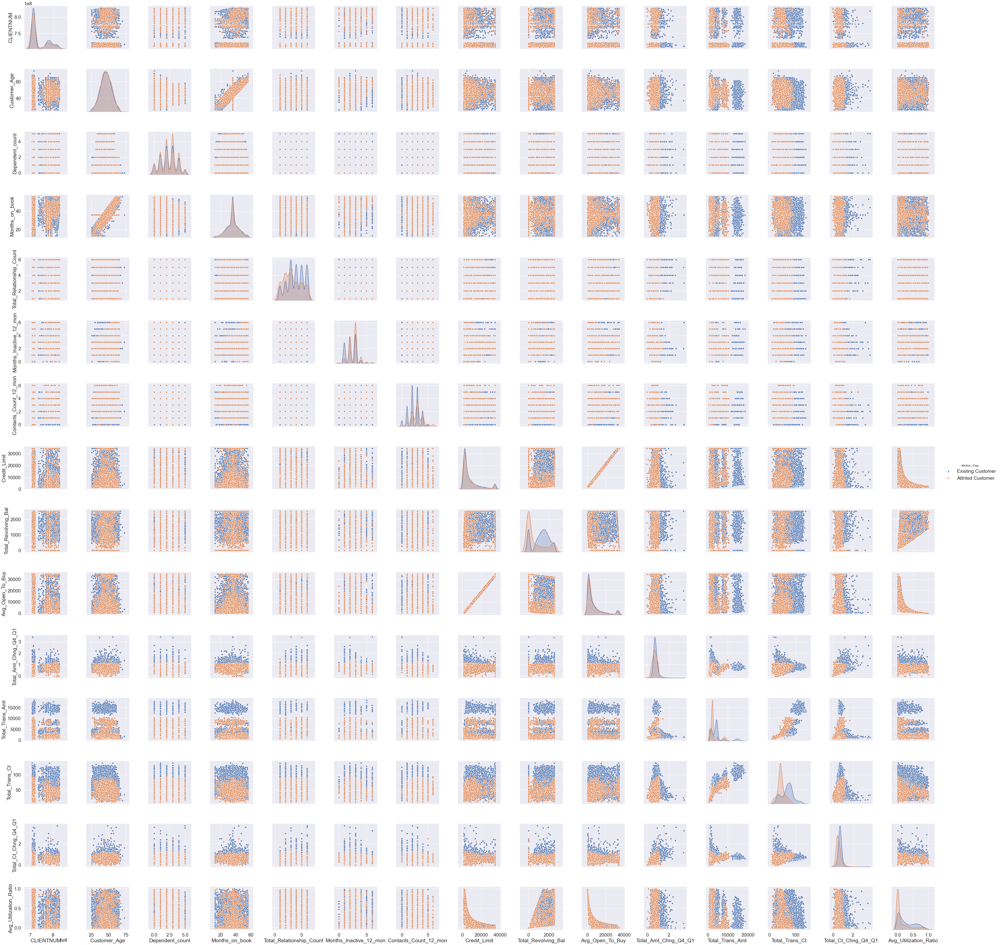

In [176]:
%%time

sns.pairplot(data1,hue='Attrition_Flag',height=3.5)

### Heatmap

AttributeError: 'QuadMesh' object has no property 'cent5er'

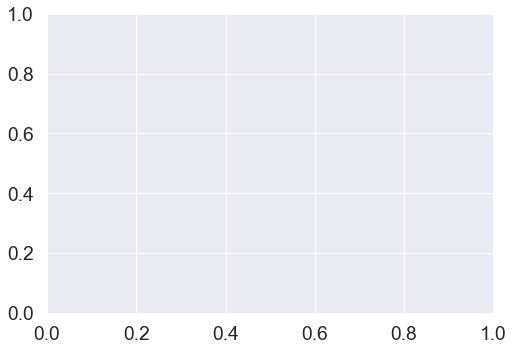

In [177]:
##### fig, ax = plt.subplots(figsize=(1,6))
sns.heatmap(data1.corr(), cent5er=0, cmap='BrBG', annot=True)

Observation:
Positive correlation between
    Months on book and customer age
    total revolving balance and Average utilisation   and total ct change in QA to Q1  
    Credit limit to total transaction amount,total transact ct and dependent count
    Average open to buy to transaction amount
    Total Transaction amount to total transaction ct
Negetive Correlation
    Average open to buy to Avg Utilization ratio
    Credit limit to Average utilisation ratio
    Total relationship ct to totatl trasaction ct total transaction ct
    

    


### observation on Attrition_Flag' vs months on book

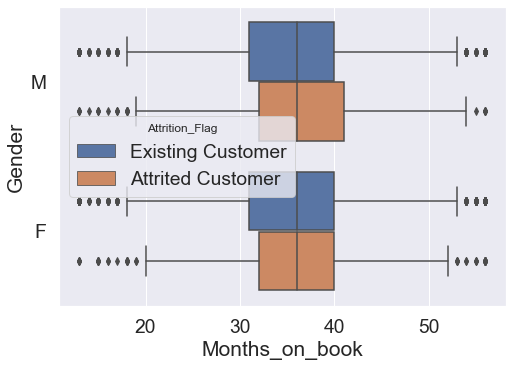

In [161]:
#sns.scatterplot(x='Months_on_book',data=data1,hue='Attrition_Flag')
sns.boxplot(x='Months_on_book',y='Gender',data=data1,hue='Attrition_Flag')

### Observation on total transaction count and Attrition Flag

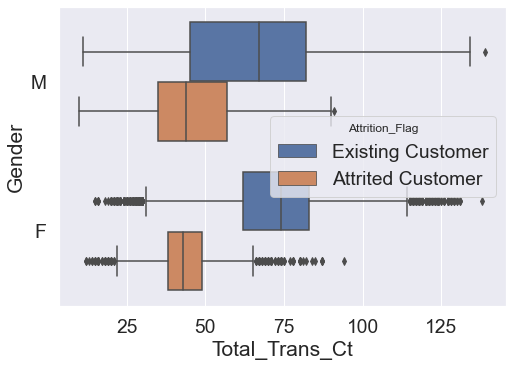

In [162]:
sns.boxplot(x='Total_Trans_Ct',y='Gender',data=data1,hue='Attrition_Flag')

Observation : the customers who has lesser Total trasaction count seems to have Atrrited

### obesrvation on Attrition and total transaction amount

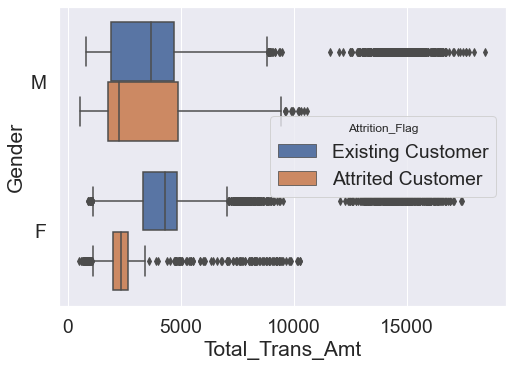

In [163]:
sns.boxplot(x='Total_Trans_Amt',y='Gender',data=data1,hue='Attrition_Flag')

Observation Female customers with lesser transaction amount seems to have Attrited 

### Observation on Avg Utilization Ration and Attrition Flag

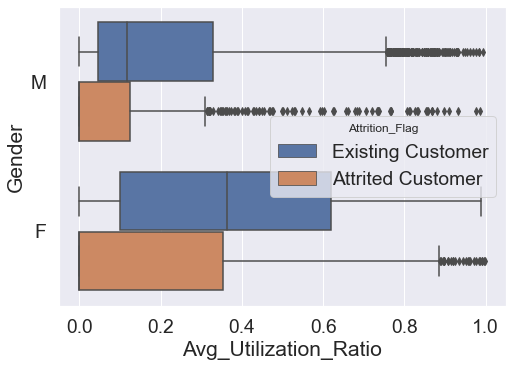

In [164]:
sns.boxplot(x='Avg_Utilization_Ratio',y='Gender',data=data1,hue='Attrition_Flag')

Observation :Customers who had lesser Avg utilisation ratio seem to have attrited more in female than in male population.

### Observation on Attrition and Total_Amt_Chng_Q4_Q1

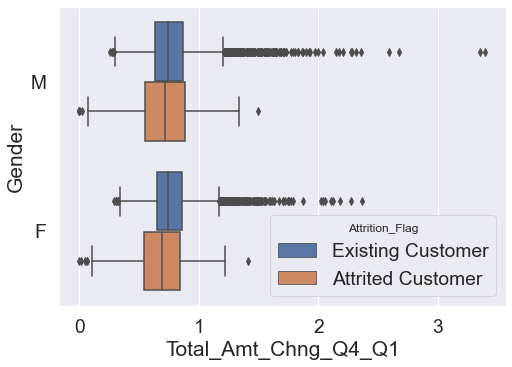

In [165]:
sns.boxplot(x='Total_Amt_Chng_Q4_Q1',y='Gender',data=data1,hue='Attrition_Flag')

Observation : customer with lesser Total Amt change Q4 to Q1 seems to have attrited 

### Observation on Total Revolving Balance and Attrited falg

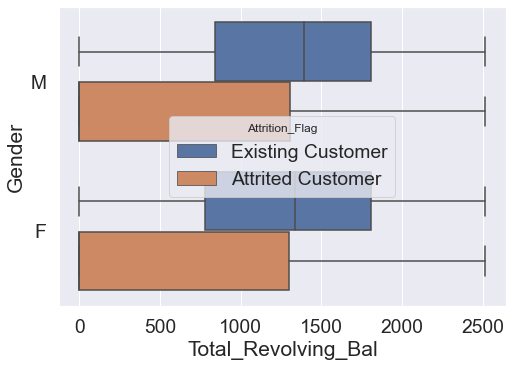

In [166]:
sns.boxplot(x='Total_Revolving_Bal',y='Gender',data=data1,hue='Attrition_Flag')

Observation: Customer with lower revolving balance seems to have attrited.

 ### Observation on Total_Relationship_Count and Attrited

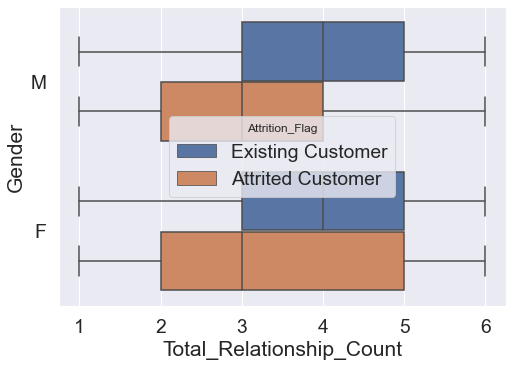

In [167]:
sns.boxplot(x='Total_Relationship_Count',y='Gender',data=data1,hue='Attrition_Flag')

Observation: Customer with lower Total_Relationship_Count seems to have attrited particularly in males.

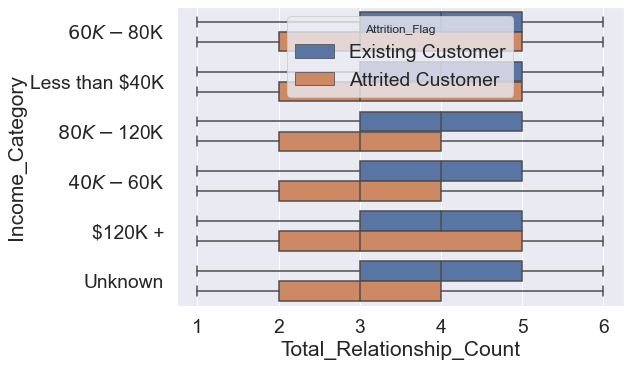

In [172]:
sns.boxplot(x='Total_Relationship_Count',y='Income_Category',data=data1,hue='Attrition_Flag')

Observation : in all the level customer with lesser relation count seems to have attrited

# Model Building - Approach
1. Partition the data into train and test set.
2. Treat missing values using Mode as most of them are not more than 15 % missing and Outlier are of market real trend so not treating them now.
3. Built different classifiers using K-Fold cross-validation, pipelines and StandardScaler.
4. Hyperparameter tuning the model which gives the best cross-validation score 
6. Build the model using optimal hyperparameters and test the performance on the test set.

### Model evaluation criterion

### We will be using Accuracy as a metric for our model performance because here company could face 2 types of losses
1. New investment and promotion to acquire the new customer

2. Not knowing the churn might loose the existing customers

3.From the Data set we see that Attrition_Flag will be taken to predict the customer who would be more likely to stop using the Credit card

4.The Data set seems to be Unbalanced from Attrition_Flag column

5.Attrited is just 16.1% and existing customer is 83.9% this data set is an imbalanced data set


We can see the data is more inclined towards a unbalanced set so we are considering Recall and precision rather than accuracy


### Which Loss is greater? 
* It costs more to acquire new customers than it does to retain existing ones. 

### How to reduce this loss 
* Take more effort to predict accurately the type of customer who would likely stop doing business with  them.
* Using the historical data analyse the customer churn
* Company wants Accuracy to be maximized.To predict accurately which customer is more likely to leave.

# Preprocessing the Data

### Splitting data into training, validation and test set:

In [31]:
data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

# Feature Engineering

### Dropping Clienium as this is unique value for each customer

In [32]:
data=data.drop(['CLIENTNUM'],axis=1)
data_copy=data.copy()

### Convert Unknown Values to NaN and replace with Mode in the places of NaN

In [33]:
data=data.replace('Unknown',np.NaN)

In [34]:
data["Education_Level"]=data["Education_Level"].fillna("Graduate")

In [35]:
data["Income_Category"]=data["Income_Category"].fillna("Less than $40K")

In [36]:
data["Marital_Status"]=data["Marital_Status"].fillna("Married")

In [37]:
# Making a list of all catrgorical variables
cat_col = [
    "Attrition_Flag",
    "Gender",
    "Education_Level",
    "Marital_Status",            
    "Income_Category",
    "Card_Category"
]

# Printing number of count of each unique value in each column
for column in cat_col:
    print(data[column].value_counts())

    print("-" * 40)
    

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64
----------------------------------------
F    5358
M    4769
Name: Gender, dtype: int64
----------------------------------------
Graduate         4647
High School      2013
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64
----------------------------------------
Married     5436
Single      3943
Divorced     748
Name: Marital_Status, dtype: int64
----------------------------------------
Less than $40K    4673
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
$120K +            727
Name: Income_Category, dtype: int64
----------------------------------------
Blue        9436
Silver       555
Gold         116
Platinum      20
Name: Card_Category, dtype: int64
----------------------------------------


### Encoding Categorical Variables

In [38]:
scale_mapper = {"Uneducated":1, "High School":2, "College":3,"Graduate":4,"Post-Graduate":5,"Doctorate":5}
 
data1 = data["Education_Level"].replace(scale_mapper)



data2=pd.get_dummies(data.Gender)
data3=pd.get_dummies(data.Attrition_Flag)

In [39]:
def binary_encoding(data,column,positive_values):
    data=data.copy()
    data[column]=data[column].apply(lambda x:1 if x==positive_values else 0)
    return data

In [40]:
data=binary_encoding(data, 'Attrition_Flag' ,positive_values= 'Attrited Customer')
data=binary_encoding(data, 'Gender' ,positive_values= 'M')


In [41]:
scale_mapper1 = {"Married":3, "Single":2, "Divorced":1}

 
data4 = data["Marital_Status"].replace(scale_mapper1)

In [42]:
scale_mapper2 = {"Less than $40K":0, "$40K - $60K":1, "$80K - $120K":2,"$60K - $80K":3,"$120K +":4}

 
data5 = data["Income_Category"].replace(scale_mapper2)

In [43]:

scale_mapper3 = {"Blue":0, "Silver":1, "Gold":2,"Platinum":3}

 
data6 = data["Card_Category"].replace(scale_mapper3)

In [44]:
#data=data.drop('Card_Category','Income_Category','Marital_Status')
data=data.drop(['Card_Category','Income_Category','Marital_Status','Education_Level'],axis=1)

In [45]:
data_final=pd.concat([data,data1,data4,data5,data6],axis='columns')

In [46]:
data_final.nunique()

Attrition_Flag                 2
Customer_Age                  45
Gender                         2
Dependent_count                6
Months_on_book                44
Total_Relationship_Count       6
Months_Inactive_12_mon         7
Contacts_Count_12_mon          7
Credit_Limit                6205
Total_Revolving_Bal         1974
Avg_Open_To_Buy             6813
Total_Amt_Chng_Q4_Q1        1158
Total_Trans_Amt             5033
Total_Trans_Ct               126
Total_Ct_Chng_Q4_Q1          830
Avg_Utilization_Ratio        964
Education_Level                5
Marital_Status                 3
Income_Category                5
Card_Category                  4
dtype: int64

In [47]:
data_final.head(5)

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Education_Level,Marital_Status,Income_Category,Card_Category
0,0,45,1,3,39,5,1,3,12691,777,11914,1,1144,42,2,0,2,3,3,0
1,0,49,0,5,44,6,1,2,8256,864,7392,2,1291,33,4,0,4,2,0,0
2,0,51,1,3,36,4,1,0,3418,0,3418,3,1887,20,2,0,4,3,2,0
3,0,40,0,4,34,3,4,1,3313,2517,796,1,1171,20,2,1,2,3,0,0
4,0,40,1,3,21,5,1,0,4716,0,4716,2,816,28,2,0,1,3,3,0


In [48]:
data_final.shape

(10127, 20)

In [49]:
data_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  int64  
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  int64  
 3   Dependent_count           10127 non-null  int64  
 4   Months_on_book            10127 non-null  int64  
 5   Total_Relationship_Count  10127 non-null  int64  
 6   Months_Inactive_12_mon    10127 non-null  int64  
 7   Contacts_Count_12_mon     10127 non-null  int64  
 8   Credit_Limit              10127 non-null  float64
 9   Total_Revolving_Bal       10127 non-null  int64  
 10  Avg_Open_To_Buy           10127 non-null  float64
 11  Total_Amt_Chng_Q4_Q1      10127 non-null  float64
 12  Total_Trans_Amt           10127 non-null  int64  
 13  Total_Trans_Ct            10127 non-null  int64  
 14  Total_

All columns are encoded and ready to be fed to the model


### Splitting Data

In [50]:
X = data_final.drop(["Attrition_Flag"], axis=1)
y = data_final["Attrition_Flag"]

In [51]:
# first we split data into 2 parts, say temporary and test
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=1, stratify=y)

In [52]:
print("X=", X.shape)
print("y=",y.shape)
print("X_train",X_train.shape)
print("X_test",X_test.shape)
print("y_temp",X_train.shape)
print("y_test",X_test.shape)




X= (10127, 19)
y= (10127,)
X_train (8101, 19)
X_test (2026, 19)
y_temp (8101, 19)
y_test (2026, 19)


### Function for Confusion Matrix and Metrics score -Accuracy Recall and Precision

In [53]:
##  Function to calculate different metric scores of the model - Accuracy, Recall and Precision
def get_metrics_score(model, flag=True):
    """
    model : classifier to predict values of X

    """
    # defining an empty list to store train and test results
    score_list = []

    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    train_acc = model.score(X_train, y_train)
    test_acc = model.score(X_test, y_test)

    train_recall = metrics.recall_score(y_train, pred_train)
    test_recall = metrics.recall_score(y_test, pred_test)

    train_precision = metrics.precision_score(y_train, pred_train)
    test_precision = metrics.precision_score(y_test, pred_test)

    score_list.extend(
        (
            train_acc,
            test_acc,
            train_recall,
            test_recall,
            train_precision,
            test_precision,
        )
    )

    # If the flag is set to True then only the following print statements will be dispayed. The default value is set to True.
    if flag == True:
        print("Accuracy on training set : ", model.score(X_train, y_train))
        print("Accuracy on test set : ", model.score(X_test, y_test))
        print("Recall on training set : ", metrics.recall_score(y_train, pred_train))
        print("Recall on test set : ", metrics.recall_score(y_test, pred_test))
        print(
            "Precision on training set : ", metrics.precision_score(y_train, pred_train)
        )
        print("Precision on test set : ", metrics.precision_score(y_test, pred_test))

    return score_list  # returning the list with train and test scores

In [54]:
## Function to create confusion matrix
def make_confusion_matrix(model, y_actual, labels=[1, 0]):
    """
    model : classifier to predict values of X
    y_actual : ground truth

    """
    y_predict = model.predict(X_test)
    cm = metrics.confusion_matrix(y_actual, y_predict, labels=[0, 1])
    data_cm = pd.DataFrame(
        cm,
        index=[i for i in ["Actual - No", "Actual - Yes"]],
        columns=[i for i in ["Predicted - No", "Predicted - Yes"]],
    )
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)
    plt.figure(figsize=(10, 7))
    sns.heatmap(data_cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

# Model Building Logistic Regression

In [55]:
lr = LogisticRegression(random_state=1)
lr.fit(X_train,y_train)

LogisticRegression(random_state=1)

In [57]:
##  Function to calculate different metric scores of the model - Accuracy, Recall and Precision
def get_metrics_score1(model,train,test,train_y,test_y,flag=True):
    '''
    model : classifier to predict values of X

    '''
    # defining an empty list to store train and test results
    score_list=[] 
    
    pred_train = model.predict(train)
    pred_test = model.predict(test)
    
    train_acc = model.score(train,train_y)
    test_acc = model.score(test,test_y)
    
    train_recall = metrics.recall_score(train_y,pred_train)
    test_recall = metrics.recall_score(test_y,pred_test)
    
    train_precision = metrics.precision_score(train_y,pred_train)
    test_precision = metrics.precision_score(test_y,pred_test)
    
    score_list.extend((train_acc,test_acc,train_recall,test_recall,train_precision,test_precision))
        
    # If the flag is set to True then only the following print statements will be displayed. The default value is set to True.
    if flag == True: 
        print("Accuracy on training set : ",model.score(train,train_y))
        print("Accuracy on test set : ",model.score(test,test_y))
        print("Recall on training set : ",metrics.recall_score(train_y,pred_train))
        print("Recall on test set : ",metrics.recall_score(test_y,pred_test))
        print("Precision on training set : ",metrics.precision_score(train_y,pred_train))
        print("Precision on test set : ",metrics.precision_score(test_y,pred_test))
    
    return score_list # returning the list with train and test scores

Accuracy on training set :  0.8776694235279595
Accuracy on test set :  0.8775913129318855
Recall on training set :  0.44930875576036866
Recall on test set :  0.4430769230769231
Precision on training set :  0.681024447031432
Precision on test set :  0.6824644549763034


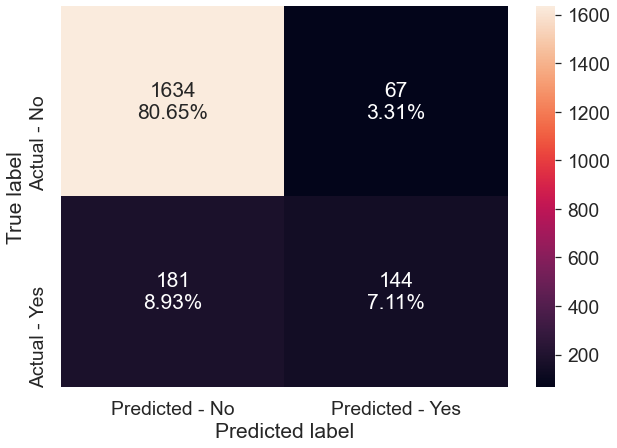

In [76]:
#Calculating different metrics
scores_LR = get_metrics_score1(lr,X_train,X_test,y_train,y_test)

make_confusion_matrix(lr,y_test)

**Let's evaluate the model performance by using KFold and cross_val_score**

- `K-Folds cross-validation` provides dataset indices to split data into train/validation sets. Split dataset into k consecutive stratified folds (without shuffling by default). Each fold is then used once as validation while the k - 1 remaining folds form the training set.

[0.88340531 0.88950617 0.87469136 0.88703704 0.87716049]


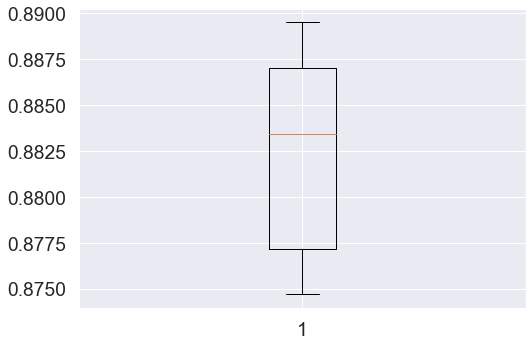

In [59]:
scoring='accuracy'
kfold=StratifiedKFold(n_splits=5,shuffle=True,random_state=1)     #Setting number of splits equal to 5
cv_result_bfr=cross_val_score(estimator=lr, X=X_train, y=y_train, scoring=scoring, cv=kfold)
print(cv_result_bfr)
#Plotting boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

[0.72307443 0.75220588 0.70760747 0.74762443 0.67759001]


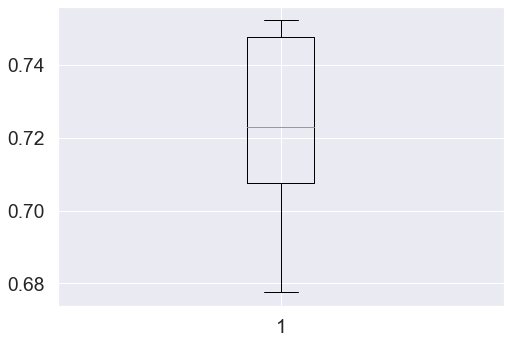

In [60]:
scoring='balanced_accuracy'
kfold=StratifiedKFold(n_splits=5,shuffle=True,random_state=1)     #Setting number of splits equal to 5
cv_result_bfr=cross_val_score(estimator=lr, X=X_train, y=y_train, scoring=scoring, cv=kfold)
print(cv_result_bfr)
#Plotting boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

## Improving LR with DownSampling

In [69]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state = 1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

In [70]:
print("Before Under Sampling, counts of label 'Yes': {}".format(sum(y_train==1)))
print("Before Under Sampling, counts of label 'No': {} \n".format(sum(y_train==0)))

print("After Under Sampling, counts of label 'Yes': {}".format(sum(y_train_un==1)))
print("After Under Sampling, counts of label 'No': {} \n".format(sum(y_train_un==0)))

print('After Under Sampling, the shape of train_X: {}'.format(X_train_un.shape))
print('After Under Sampling, the shape of train_y: {} \n'.format(y_train_un.shape))

Before Under Sampling, counts of label 'Yes': 1302
Before Under Sampling, counts of label 'No': 6799 

After Under Sampling, counts of label 'Yes': 1302
After Under Sampling, counts of label 'No': 1302 

After Under Sampling, the shape of train_X: (2604, 19)
After Under Sampling, the shape of train_y: (2604,) 



## LR on under sample data

In [71]:
log_reg_under = LogisticRegression(random_state = 1)
log_reg_under.fit(X_train_un,y_train_un )

LogisticRegression(random_state=1)

[0.80384615 0.78461538 0.83141762 0.84291188 0.83846154]


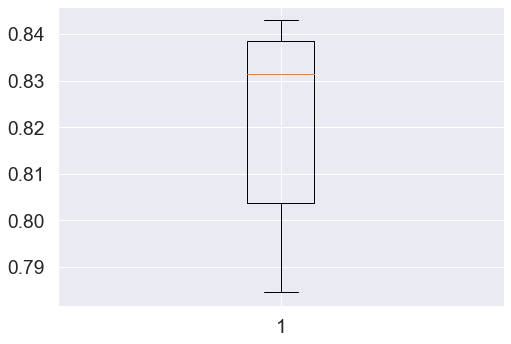

In [73]:
scoring='recall'
kfold=StratifiedKFold(n_splits=5,shuffle=True,random_state=1)     #Setting number of splits equal to 5
cv_result_under=cross_val_score(estimator=log_reg_under, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold)
print(cv_result_under)
#Plotting boxplots for CV scores of model defined above
plt.boxplot(cv_result_under)
plt.show()

Performance of model on training set varies between 0.78 to 0.84, which is an improvement from the initial model(without oversampling)
Let's check the performance on the test set.

Accuracy on training set :  0.8052995391705069
Accuracy on test set :  0.7872655478775913
Recall on training set :  0.7987711213517665
Recall on test set :  0.8246153846153846
Precision on training set :  0.8093385214007782
Precision on test set :  0.4174454828660436


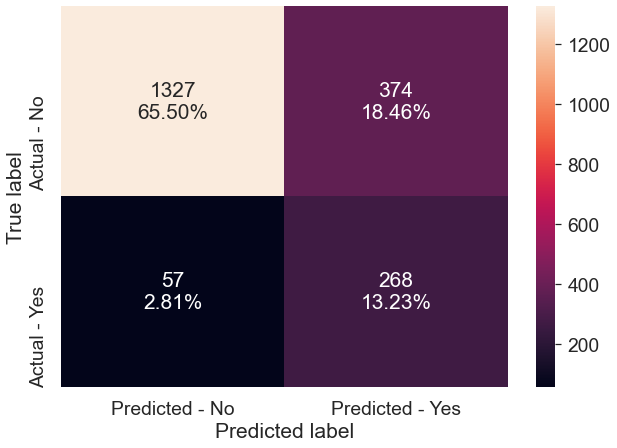

In [74]:
#Calculating different metrics
get_metrics_score1(log_reg_under,X_train_un,X_test,y_train_un,y_test)


# creating confusion matrix
make_confusion_matrix(log_reg_under,y_test)

<p>Model has given a generalized performance on training and test set.</p>
<p>Model performance has'nt improved using downsampling </p>
<p>Logistic regression is now able to differentiate well between positive and negative classes.</p>

## Improving LR with OverSampling

In [61]:
!pip install imbalanced-learn==0.8.0


In [62]:
!pip install delayed

In [63]:
from imblearn.over_sampling import SMOTE

In [64]:
print("Before UpSampling, counts of label 'Yes': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label 'No': {} \n".format(sum(y_train==0)))

sm = SMOTE(sampling_strategy = 1 ,k_neighbors = 5, random_state=1)   #Synthetic Minority Over Sampling Technique
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)


print("After UpSampling, counts of label 'Yes': {}".format(sum(y_train_over==1)))
print("After UpSampling, counts of label 'No': {} \n".format(sum(y_train_over==0)))


print('After UpSampling, the shape of train_X: {}'.format(X_train_over.shape))
print('After UpSampling, the shape of train_y: {} \n'.format(y_train_over.shape))

Before UpSampling, counts of label 'Yes': 1302
Before UpSampling, counts of label 'No': 6799 

After UpSampling, counts of label 'Yes': 6799
After UpSampling, counts of label 'No': 6799 

After UpSampling, the shape of train_X: (13598, 19)
After UpSampling, the shape of train_y: (13598,) 



## LR on Oversampled data

In [65]:
log_reg_over = LogisticRegression(random_state = 1)

# Training the basic logistic regression model with training set 
log_reg_over.fit(X_train_over,y_train_over)

LogisticRegression(random_state=1)

Accuracy on training set :  0.8234299161641417
Accuracy on test set :  0.8129318854886476
Recall on training set :  0.8168848360052949
Recall on test set :  0.8276923076923077
Precision on training set :  0.8277198211624441
Precision on test set :  0.4543918918918919


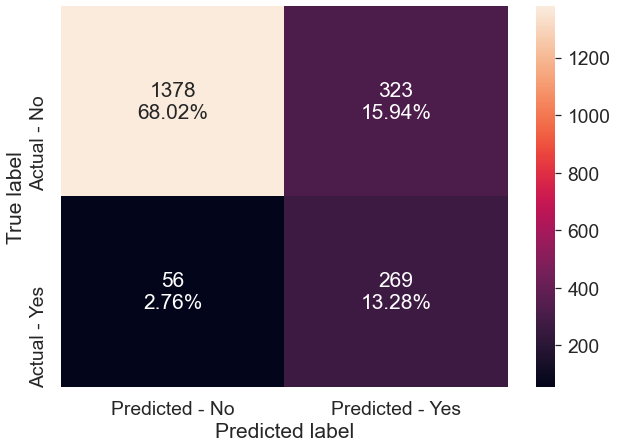

In [66]:
#Calculating different metrics
get_metrics_score1(log_reg_over,X_train_over,X_test,y_train_over,y_test)

# creating confusion matrix
make_confusion_matrix(log_reg_over,y_test)

* Performance on the training set hasnt improved much but less that LR 

* Lets try:

  a) Regularization to compare with oversampling

  b) Undersampling the train to handle the imbalance between classes and check the model performance.

## Regularising

In [67]:
%%time
# Choose the type of classifier. 
lr_estimator = LogisticRegression(random_state=1,solver='saga')

# Grid of parameters to choose from
parameters = {'C': np.arange(0.1,1.1,0.1)}

# Run the grid search
grid_obj = GridSearchCV(lr_estimator, parameters, scoring='recall')
grid_obj = grid_obj.fit(X_train_over, y_train_over)

# Set the clf to the best combination of parameters
lr_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
lr_estimator.fit(X_train_over, y_train_over)

LogisticRegression(C=0.1, random_state=1, solver='saga')

Accuracy on training set :  0.7082659214590381
Accuracy on test set :  0.7744323790720632
Recall on training set :  0.5865568465950876
Recall on test set :  0.5415384615384615
Precision on training set :  0.7752721617418351
Precision on test set :  0.36363636363636365


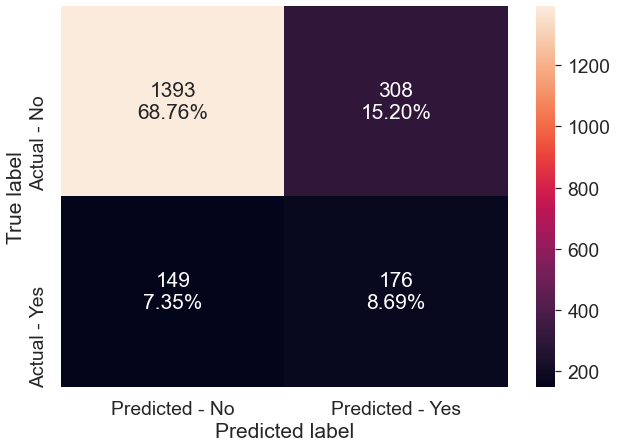

In [68]:
#Calculating different metrics
get_metrics_score1(lr_estimator,X_train_over,X_test,y_train_over,y_test)

# creating confusion matrix
make_confusion_matrix(lr_estimator,y_test)

* Model performance hasn't improved much after regularization.

<p>Observation : LR seems to give a better accuracy with .87 in both test and train set </p>


# Model Building Bagging Classifier

## Build Decision tree 

Accuracy on training set :  1.0
Accuracy on test set :  0.9323790720631787
Recall on training set :  1.0
Recall on test set :  0.8276923076923077
Precision on training set :  1.0
Precision on test set :  0.7685714285714286


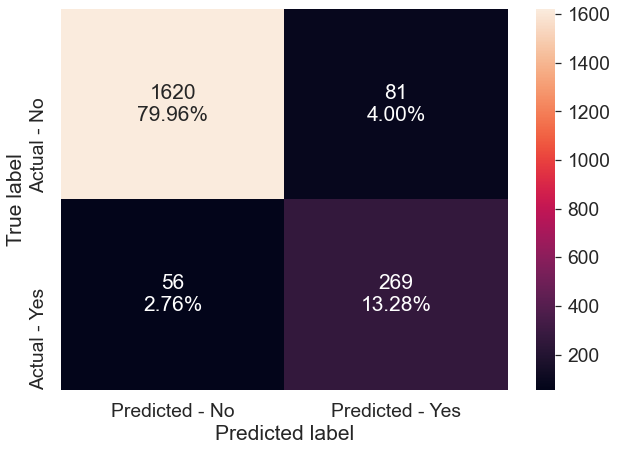

In [83]:
#Fitting the model
d_tree = DecisionTreeClassifier(random_state=1)
d_tree.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(d_tree)

#Creating confusion matrix
make_confusion_matrix(d_tree,y_test)

DT is overfitting as all the values are 1

## Building Random Forest

Accuracy on training set :  1.0
Accuracy on test set :  0.9698914116485686
Recall on training set :  1.0
Recall on test set :  0.8676923076923077
Precision on training set :  1.0
Precision on test set :  0.94


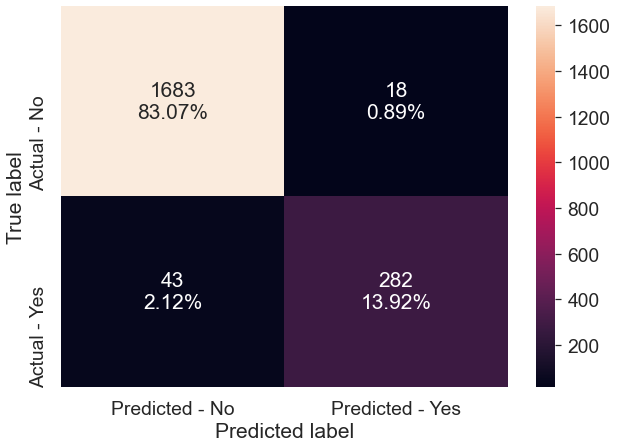

In [84]:
#Fitting the model
rf_estimator = RandomForestClassifier(random_state=1)
rf_estimator.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(rf_estimator)

#Creating confusion matrix
make_confusion_matrix(rf_estimator,y_test)

RF also seems to over fit with perfit score 1

## Bagging Classifier model 

Accuracy on training set :  0.9967905196889273
Accuracy on test set :  0.9595261599210266
Recall on training set :  0.9823348694316436
Recall on test set :  0.8676923076923077
Precision on training set :  0.9976599063962559
Precision on test set :  0.8785046728971962


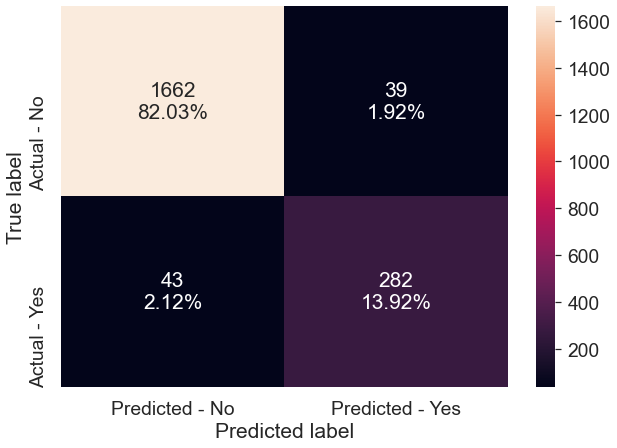

In [85]:
#Fitting the model
bagging_classifier = BaggingClassifier(random_state=1)
bagging_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(bagging_classifier)

#Creating confusion matrix
make_confusion_matrix(bagging_classifier,y_test)

Bagging classifier seems to do better than other two bagging classifier with accuracy ontest set .95

# Model Building- Boosting

## Build Xgboost  

In [93]:
from xgboost import XGBClassifier

In [94]:
xgb = XGBClassifier(random_state=1)
xgb.fit(X_train,y_train)

[19:23:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [95]:
#Using above defined function to get accuracy, recall and precision on train and test set
xgb_score=get_metrics_score(xgb)

Accuracy on training set :  1.0
Accuracy on test set :  0.9782823297137216
Recall on training set :  1.0
Recall on test set :  0.9292307692307692
Precision on training set :  1.0
Precision on test set :  0.934984520123839


observation : XGBoost seems to be overfitting 

## Build AdaBoost

In [86]:
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

In [87]:
abc = AdaBoostClassifier(random_state=1)
abc.fit(X_train,y_train)

AdaBoostClassifier(random_state=1)

In [88]:
abc_score=get_metrics_score(abc)

Accuracy on training set :  0.9602518207628687
Accuracy on test set :  0.9664363277393879
Recall on training set :  0.84715821812596
Recall on test set :  0.9015384615384615
Precision on training set :  0.899673735725938
Precision on test set :  0.8905775075987842


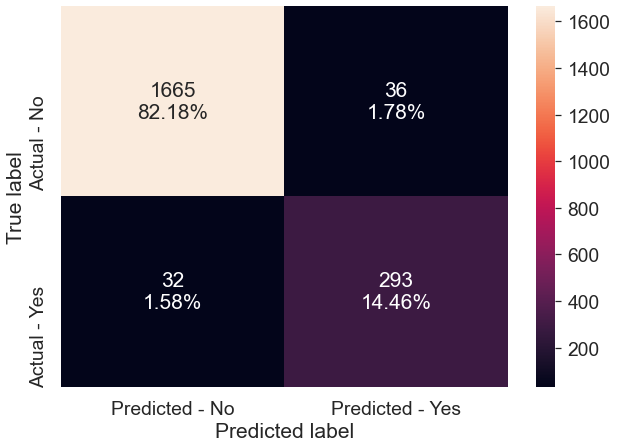

In [89]:
make_confusion_matrix(abc,y_test)

Observation the accuracy seems to be doing good with Ada boosting with 96% in test set

## Build Gradient Boosting model

In [90]:
gbc = GradientBoostingClassifier(random_state=1)
gbc.fit(X_train,y_train)

GradientBoostingClassifier(random_state=1)

In [91]:
#Using above defined function to get accuracy, recall and precision on train and test set
gbc_score=get_metrics_score(gbc)

Accuracy on training set :  0.9742007159609924
Accuracy on test set :  0.9713721618953604
Recall on training set :  0.880184331797235
Recall on test set :  0.8892307692307693
Precision on training set :  0.9557964970809008
Precision on test set :  0.9292604501607717


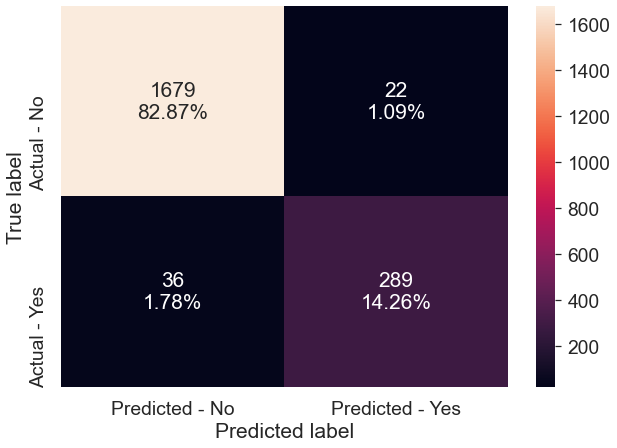

In [92]:
make_confusion_matrix(gbc,y_test)

GB seems to be better than all three of the models above with accuracy of 97%

# Finding the CV score for different models

In [173]:
import warnings

warnings.filterwarnings("ignore")

models = []  # Empty list to store all the models
# Appending pipelines for each model into the list
models.append(
    (
        "LR",
        Pipeline(
            steps=[
                ("scaler", StandardScaler()),
                ("log_reg", LogisticRegression(random_state=1)),
            ]
        ),
    )
)
models.append(
    (
        "RF",
        Pipeline(
            steps=[
                ("scaler", StandardScaler()),
                ("random_forest", RandomForestClassifier(random_state=1)),
            ]
        ),
    )
)
models.append(
    (
        "GBM",
        Pipeline(
            steps=[
                ("scaler", StandardScaler()),
                ("gradient_boosting", GradientBoostingClassifier(random_state=1)),
            ]
        ),
    )
)
models.append(
    (
        "ADB",
        Pipeline(
            steps=[
                ("scaler", StandardScaler()),
                ("adaboost", AdaBoostClassifier(random_state=1)),
            ]
        ),
    )
)
models.append(
    (
        "XGB",
        Pipeline(
            steps=[
                ("scaler", StandardScaler()),
                ("xgboost", XGBClassifier(random_state=1)),
            ]
        ),
    )
)
models.append(
    (
        "DTREE",
        Pipeline(
            steps=[
                ("scaler", StandardScaler()),
                ("decision_tree", DecisionTreeClassifier(random_state=1)),
            ]
        ),
    )
)

results = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models

# loop through all models to get the mean cross validated score
for name, model in models:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scoring, cv=kfold
    )
    results.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean() * 100))

LR: 57.7597995873858
RF: 79.7995873857943
GBM: 83.64073091659299
ADB: 82.79516651930446
[15:20:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:20:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:20:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore 

## Plotting boxplots for CV scores of all models defined above

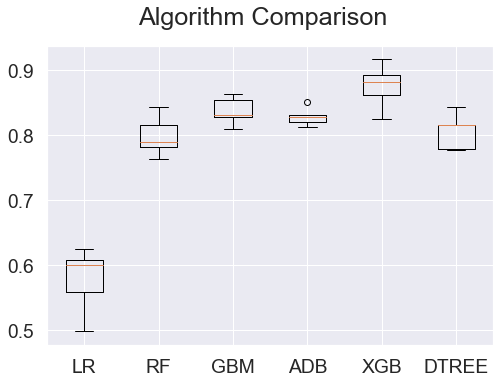

In [174]:

fig = plt.figure()

fig.suptitle("Algorithm Comparison")
ax = fig.add_subplot(111)

plt.boxplot(results)
ax.set_xticklabels(names)

plt.show()

- We can see that the xgboost is giving the highest cross-validated score followed by Gradient boost and ADA boost
- The boxplot shows that the performance of XGB is consistent 
- We will tune the best three models i.e. xgboost and  GBM and ADB and see if the performance improves 

# Hyperparameter Tuning-using grid search

## GBC-Tuned-GridSearch

In [96]:
%%time
# Choose the type of classifier. 
gbc_tuned = GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [50,100,150,200],
    "subsample":[0.8,0.9,1],
    "max_features":[0.7,0.8,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(gbc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gbc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gbc_tuned.fit(X_train, y_train)

Wall time: 14min 9s


GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                           max_features=0.9, n_estimators=200, random_state=1,
                           subsample=0.8)

In [97]:
gbc_tuned_score=get_metrics_score(gbc_tuned)

Accuracy on training set :  0.9840760399950623
Accuracy on test set :  0.9782823297137216
Recall on training set :  0.9301075268817204
Recall on test set :  0.916923076923077
Precision on training set :  0.9695756605284227
Precision on test set :  0.946031746031746


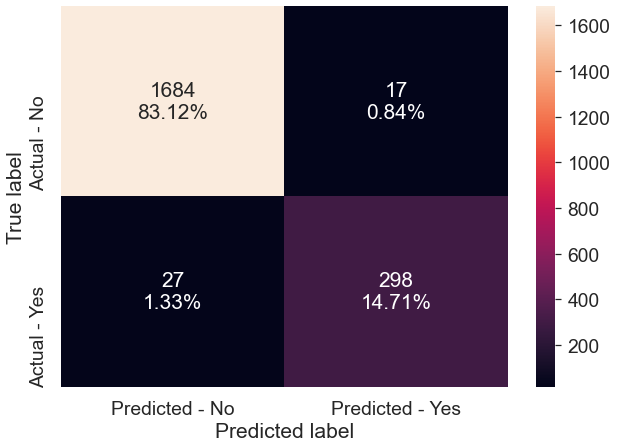

In [98]:
make_confusion_matrix(gbc_tuned,y_test)

Observation

GBC using Grid search CV has 97% accuracy in test set 

Accuracy on training set :  0.9840760399950623

Accuracy on test set :  0.9782823297137216

In [99]:
from sklearn.metrics import roc_auc_score
y_pred=gbc_tuned.predict(X_test)
roc_auc_score(y_test,y_pred)

0.9534644779089224

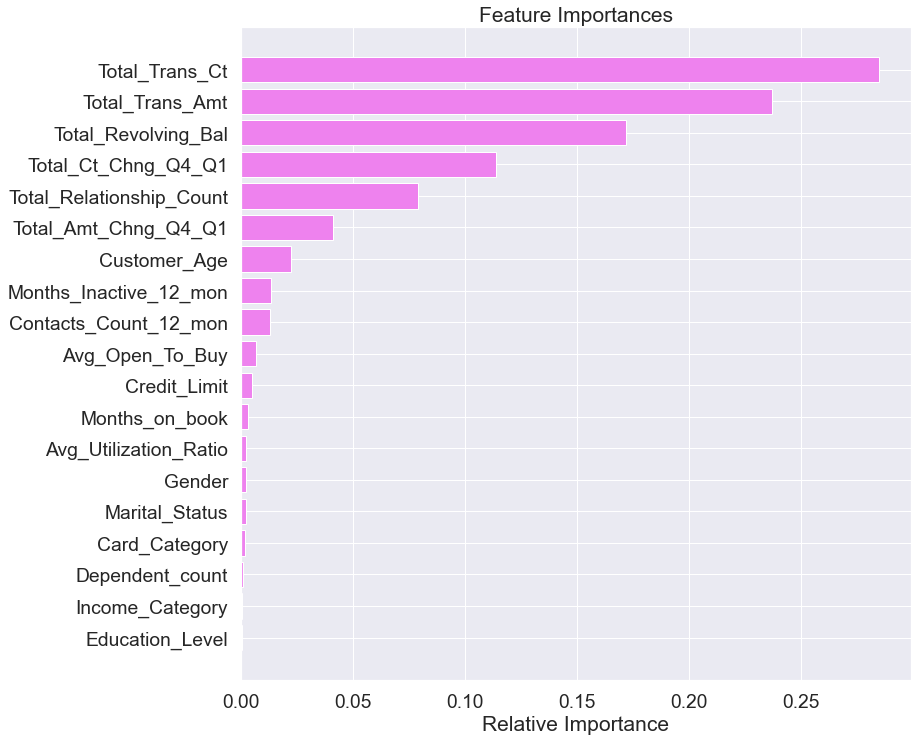

In [100]:
importances = gbc_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

In [ ]:
Total transaction count,Total transaction amount,total revolving balance ,Total_Ct_Chng_Q4_Q1,Total Relationship count

## ADA Boost -Tuned-GridsearchCV

In [101]:
%%time
# Choose the type of classifier. 
abc_tuned = AdaBoostClassifier(random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    #Let's try different max_depth for base_estimator
    "base_estimator":[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),DecisionTreeClassifier(max_depth=3)],
    "n_estimators": np.arange(10,50,10),
    "learning_rate":np.arange(0.1,2,0.1)
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(abc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
abc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
abc_tuned.fit(X_train, y_train)

Wall time: 6min 46s


AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3),
                   learning_rate=0.8, n_estimators=40, random_state=1)

In [102]:
#Using above defined function to get accuracy, recall and precision on train and test set
abc_tuned_score=get_metrics_score(abc_tuned)

Accuracy on training set :  0.9924700654240217
Accuracy on test set :  0.9758144126357354
Recall on training set :  0.9723502304147466
Recall on test set :  0.9230769230769231
Precision on training set :  0.9806351665375678
Precision on test set :  0.9259259259259259


In [103]:
from sklearn.metrics import roc_auc_score
y_pred=abc_tuned.predict(X_test)
roc_auc_score(y_test,y_pred)

0.9544837878171212

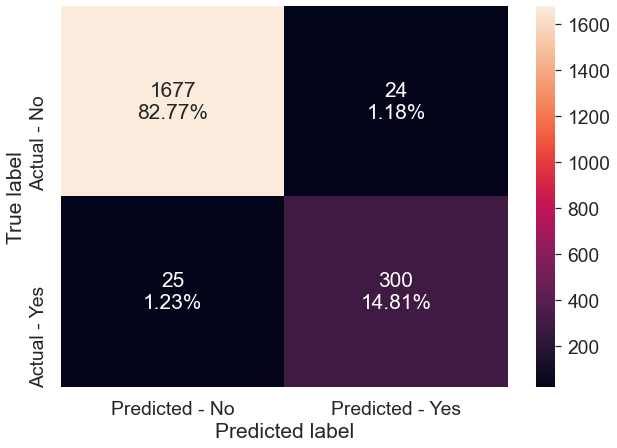

In [104]:
make_confusion_matrix(abc_tuned,y_test)

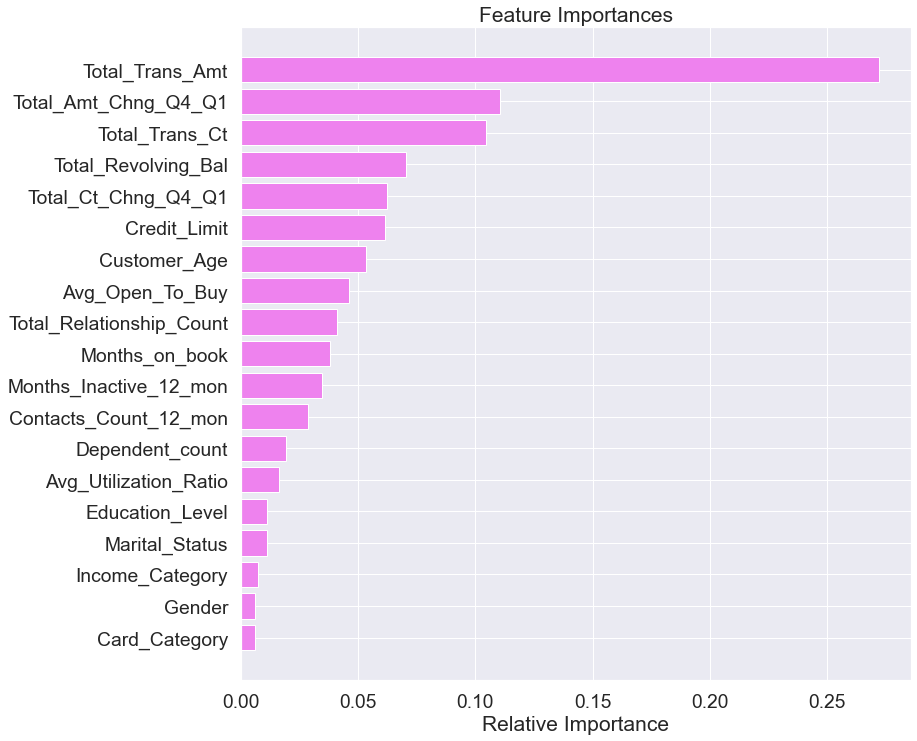

In [105]:
importances = abc_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

## XGB-Tuned-Gridsearch

In [107]:
%%time
# Choose the type of classifier. 
xgb_tuned = XGBClassifier(random_state=1,eval_metric='mlogloss')

# Grid of parameters to choose from
## add from
parameters = {
    "n_estimators": np.arange(10,100,20),
    "scale_pos_weight":[0,1,2,5],
    "subsample":[0.5,0.7,0.9,1],
    "learning_rate":[0.01,0.1,0.2,0.05],
    "gamma":[0,1,3],
    "colsample_bytree":[0.5,0.7,0.9,1],
    "colsample_bylevel":[0.5,0.7,0.9,1],
    }

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(xgb_tuned, parameters,scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_tuned.fit(X_train, y_train)

Wall time: 4h 39min 3s


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=0.7,
              colsample_bynode=1, colsample_bytree=0.5, eval_metric='mlogloss',
              gamma=3, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.05, max_delta_step=0,
              max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=90, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=5, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)

In [108]:
xgb_tuned_score=get_metrics_score(xgb_tuned)

Accuracy on training set :  0.9739538328601407
Accuracy on test set :  0.9654491609081934
Recall on training set :  0.9915514592933948
Recall on test set :  0.9569230769230769
Precision on training set :  0.8658618376928237
Precision on test set :  0.8474114441416893


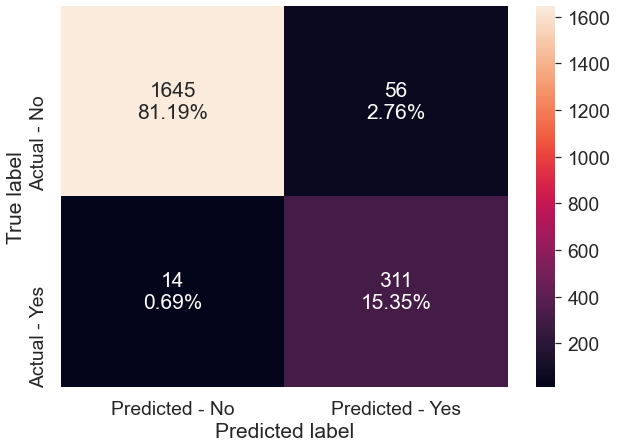

In [109]:
make_confusion_matrix(xgb_tuned,y_test)

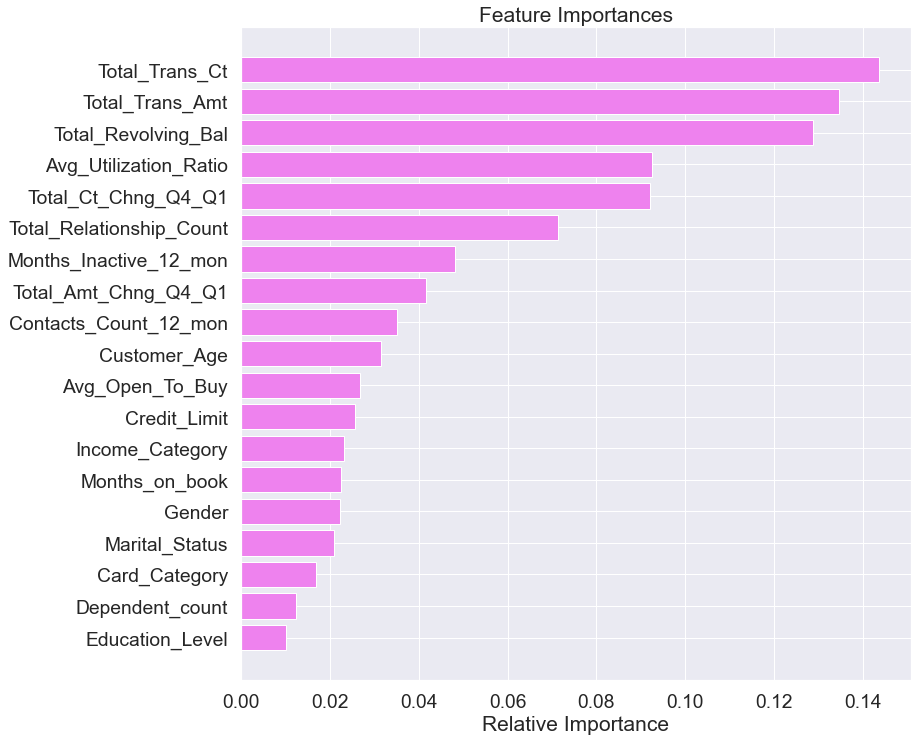

In [110]:
importances = xgb_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

In [111]:
from sklearn.metrics import roc_auc_score
y_pred=xgb_tuned.predict(X_test)
roc_auc_score(y_test,y_pred)

0.9620006331117443

In [149]:
# defining list of models
models = [abc, gbc,xgb,abc_tuned,gbc_tuned]

# defining empty lists to add train and test results
acc_train = []
acc_test = []


# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:
    print('Model:',model)
    j = get_metrics_score(model,flag=True)
        
   
    print('------------*************************-----------')

Model: AdaBoostClassifier(random_state=1)
Accuracy on training set :  0.9602518207628687
Accuracy on test set :  0.9664363277393879
Recall on training set :  0.84715821812596
Recall on test set :  0.9015384615384615
Precision on training set :  0.899673735725938
Precision on test set :  0.8905775075987842
------------*************************-----------
Model: GradientBoostingClassifier(random_state=1)
Accuracy on training set :  0.9742007159609924
Accuracy on test set :  0.9713721618953604
Recall on training set :  0.880184331797235
Recall on test set :  0.8892307692307693
Precision on training set :  0.9557964970809008
Precision on test set :  0.9292604501607717
------------*************************-----------
Model: XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max

<p><b>Obesrvation:</b>Out of all model XGBoost and Ada boost tuned seems to havea  better accuracy as 97% on test set.</p>

# Hyperparameter tuning -Random Search

## XGB tuned-Random search 

In [126]:
#Creating pipeline
pipe=make_pipeline(StandardScaler(),XGBClassifier(random_state=1))

#Parameter grid to pass in RandomizedSearchCV
param_grid={'xgbclassifier__n_estimators':np.arange(50,300,50),'xgbclassifier__scale_pos_weight':[0,1,2,5,10],
            'xgbclassifier__learning_rate':[0.01,0.1,0.2,0.05], 'xgbclassifier__gamma':[0,1,3,5],
            'xgbclassifier__subsample':[0.7,0.8,0.9,1]
           }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.accuracy_score)

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, n_iter=50, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

[08:10:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:10:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:10:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:10:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:10:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:10:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:10:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:10:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:11:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:11:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:11:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:11:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:11:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:11:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:11:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:11:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:12:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:12:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:12:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:12:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:12:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:12:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:12:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:12:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:13:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:13:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:13:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:13:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:13:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:13:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:13:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:13:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:14:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:14:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:14:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:14:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[08:14:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:14:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:14:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:14:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

In [114]:
# Creating new pipeline with best parameters
xgb_tuned2 = Pipeline(
    steps=[
        ("scaler", StandardScaler()),
        (
            "XGB",
            XGBClassifier(
                random_state=1,
                n_estimators=20,
                scale_pos_weight=10,
                learning_rate=0.01,
                gamma=1,
                subsample=0.9,
            ),
        ),
    ]
)
# Fit the model on training data
xgb_tuned2.fit(X_train, y_train)

[07:31:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Pipeline(steps=[('scaler', StandardScaler()),
                ('XGB',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, gamma=1, gpu_id=-1,
                               importance_type='gain',
                               interaction_constraints='', learning_rate=0.01,
                               max_delta_step=0, max_depth=6,
                               min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=20,
                               n_jobs=8, num_parallel_tree=1, random_state=1,
                               reg_alpha=0, reg_lambda=1, scale_pos_weight=10,
                               subsample=0.9, tree_method='exact',
                               validate_parameters=1, verbosity=None))])

Accuracy on training set :  0.9172941612146649
Accuracy on test set :  0.8998025666337611
Recall on training set :  0.978494623655914
Recall on test set :  0.9415384615384615
Precision on training set :  0.6649269311064718
Precision on test set :  0.6244897959183674


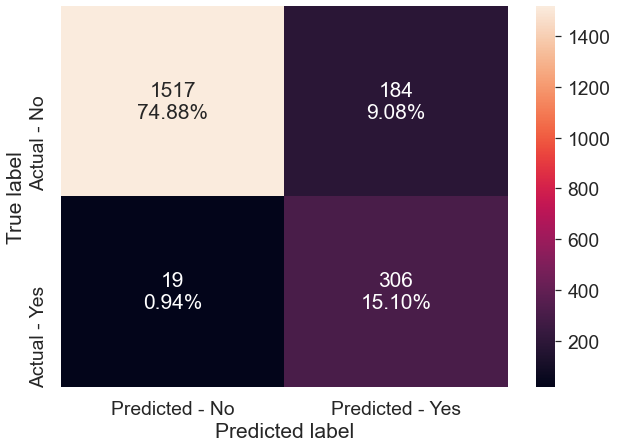

In [115]:
# Calculating different metrics
get_metrics_score(xgb_tuned2)

# Creating confusion matrix
make_confusion_matrix(xgb_tuned2, y_test)

In [137]:
# defining list of models
models = [xgb_tuned, xgb_tuned2]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []

# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:

    j = get_metrics_score(model,flag=True)
    acc_train.append(j[0])
    acc_test.append(j[1])
    recall_train.append(j[2])
    recall_test.append(j[3])
    precision_train.append(j[4])
    precision_test.append(j[5])
    print('*************************')

Accuracy on training set :  0.9739538328601407
Accuracy on test set :  0.9654491609081934
Recall on training set :  0.9915514592933948
Recall on test set :  0.9569230769230769
Precision on training set :  0.8658618376928237
Precision on test set :  0.8474114441416893
*************************
Accuracy on training set :  0.9172941612146649
Accuracy on test set :  0.8998025666337611
Recall on training set :  0.978494623655914
Recall on test set :  0.9415384615384615
Precision on training set :  0.6649269311064718
Precision on test set :  0.6244897959183674
*************************


Observation:Xgbtuned with Gridsearch seems to have better accuracy rate than random search CV

# Conclusion
<p><b>XGB withGridsearch seems to have better Accuracy rates as 96%</b> in test set in hyper parameter tuned models</p>
<p><b>XGB and ADA boost have a accuracy rate of 97% as well in the test set</b> and that is better than the one with Random search or gridsearch</p>

## Recommendation

<p>Below are the one that has more feature importance &nbsp;</p>
<p>&nbsp; &nbsp; &nbsp; &nbsp;Total_Trans_Ct</p>
<p>&nbsp; &nbsp; &nbsp; &nbsp;Total_Trans_Amt</p>
<p>&nbsp; &nbsp; &nbsp; &nbsp;Total_Revolving_Bal</p>
<p>&nbsp; &nbsp; &nbsp; &nbsp;Avg_Utilization_Ratio</p>
 <p>Hence we can suggest the company to have a closer look on these Features so that the one haing less transaction amount or ct or lesser total revolving balance and less avg utilisation may be more likely to stop the business</p>
<p>So to boost the transaction promotion can be introduced for these customer who has lesser Total trasaction amount and less than a particular Avg utilisation ratio.</p>
<p>Total ct change from Q4 to Q1 also seems to have feature importance similar to the one mentioned above.</p>
<p>The credit limit and age also seems to have some importance but not as good as the one mentioned above so we can also consider using those to introduce the Promotion who belong to particular age group with less credit limit</p>
<p>Total relationship count and Months inactive in 12 months are also having importance so company can consider having closer look into the customer who is inctive for a longer time and who has less relation ship count can be pulled out to introduce the promotional offers to boost their transactions.</p>
<p><br></p>
<p><b>XGB withGridsearch seems to have better Accuracy rates as 96%</b> in test set in hyper parameter tuned models</p>
<p><b>XGB and ADA boost have a accuracy rate of 97% as well in the test set</b> and that is better than the one with Random search or gridsearch</p>
<p>So these Models can be recommended to be deployed in production</p>

In [178]:
gs.best_params_

NameError: name 'gs' is not defined